# Spectrogram Viewer
## Imports

In [3]:
import scipy.signal as signal
import numpy as np
import matplotlib.pyplot as plt
import librosa
import IPython.display as display

# STFT Function

In [4]:
# This is my (Sahil Patel's) STFT and iSTFT functions
def stft(input_array, dft_size = 2048, hop_size = 1024, zero_pad = 0, window = 1):
    if(input_array.ndim == 1):
        input_sound = input_array
        # Calculate the total number of frames
        numFrames = int(np.ceil(input_sound.shape[0] / hop_size))

        # Zero pad the input (we can over add 0s)
        input_sound = np.append(input_sound, np.zeros(dft_size + zero_pad))

        # Create a 2D array of frames and frame data
        frames = np.empty((numFrames, dft_size + zero_pad))
        for i in range(numFrames):
            frames[i] = input_sound[i*hop_size:i*hop_size + dft_size + zero_pad]*window

        # Execute RFFT on each frame   
        frequencies = []
        past_frame = 0
        for f in frames:
            frequencies.append(np.fft.rfft(f, n = dft_size + zero_pad))

        return np.array(frequencies).T
    return None

def istft(input_array, dft_size = 2048, hop_size = 1024, zero_pad = 0, window = 1):
    if(input_array.ndim == 2):
        input_array = input_array.T # Is now [time][freq]
        numFrames = input_array.shape[0]

        # Calculating sound length. Adding dft_size to offset the effects of the ceil() applied in the non-inverse
        sound_length = numFrames * hop_size + zero_pad + dft_size
        sound = np.zeros(sound_length)

        for i in range(numFrames):
            # Uses irfft (inverse real fast fourier transform) to go back to time domain
            sound_clip = np.fft.irfft(input_array[i], dft_size + zero_pad)
            sound[i*hop_size : i*hop_size + dft_size + zero_pad] += sound_clip * window

        return sound
    return None

In [5]:
def triangle_istft(input_array, sampling_rate, dft_size = 2048, hop_size = 1024, zero_pad = 0, window = 1):
    if(input_array.ndim == 2):
        input_array = input_array.T
        numFrames = input_array.shape[0]

        # Calculating sound length. Adding dft_size to offset the effects of the ceil() applied in the non-inverse
        sound_length = numFrames * hop_size + zero_pad + dft_size
        sound = np.zeros(sound_length)

        for i in range(numFrames):
            sound_clip = triangle_ift(input_array[i], dft_size + zero_pad, sampling_rate)
            sound[i*hop_size : i*hop_size + dft_size + zero_pad] += sound_clip * window
        return sound
    return None

def triangle_ift(freq_array, sample_length, sampling_rate):
    if(freq_array.ndim == 1):
        freq_buckets = np.linspace(0, sampling_rate / 2, freq_array.shape[0])
        times = np.linspace(-sample_length/sampling_rate, sample_length/sampling_rate, 2*sample_length)
        wave = np.zeros(sample_length)
        for f in range(freq_array.shape[0]):
            if(freq_buckets[f] != 0):
                phase_delay = np.angle(freq_array[f])/(2*np.pi*freq_buckets[f]*sampling_rate)
                new_wave = np.abs(freq_array[f])*signal.sawtooth(times*freq_buckets[f], 0.5)
                wave += new_wave[int(phase_delay):int(phase_delay) + sample_length]
            else:
                wave += np.abs(freq_array[f])
        return wave
    return None

## Load Audio Files

In [10]:
# Load in sample MP3 file
audio, sampling_rate = librosa.core.load("non_8bit/Detroit Become Human - Main Theme on Piano.wav")

# Flatten audio to mono
if(audio.ndim > 1):
    audio = audio[0]
    
# Display audio file
print("Example Audio:")
display.display(display.Audio(audio, rate = sampling_rate))

Example Audio:


## Plot Waveforms (Amplitude vs. Time)

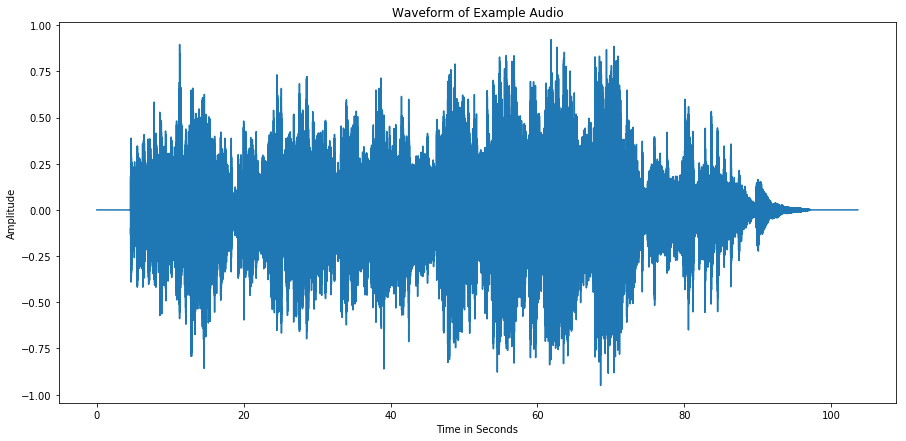

In [11]:
# Plot waveform as Amplitude vs. Time
fig, ax = plt.subplots(1, 1, figsize = (15, 7))
ax.plot(np.arange(0, audio.shape[0])/sampling_rate, audio)
ax.set_xlabel("Time in Seconds")
ax.set_ylabel("Amplitude")
ax.set_title("Waveform of Example Audio")

plt.show()

## Plot Spectrograms (Frequency, Time, and Amplitude Data)

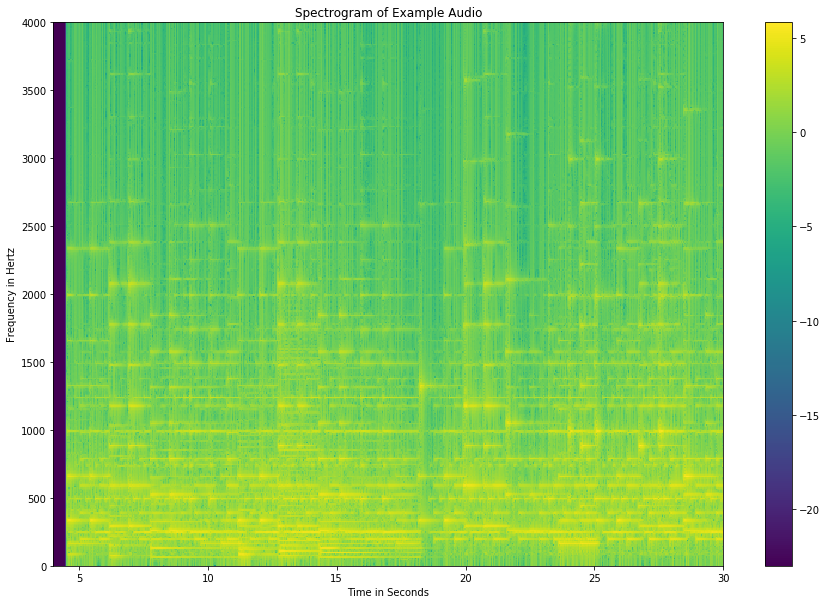

In [12]:
# Plot waveform spectrogram

spectrogram = stft(audio)
times = np.linspace(0, audio.shape[0] / sampling_rate, spectrogram.shape[1])
freqs = np.linspace(0, sampling_rate / 2, spectrogram.shape[0])

# We will have to take the log of the absolute value of the spectrogram in order to look at magnitude.
#  Taking the absolute value removes information about phase, which isn't too important to us right now.
#  Taking the log just adds contrast to our image. We wouldn't see any colors if we didn't do that.
#  We also add 1e-10 so that we don't happen to take the log of 0.
fig, ax = plt.subplots(1, 1, figsize = (15, 10))
spectrogram_graph = ax.pcolormesh(times, freqs, np.log(np.abs(spectrogram) + 1e-10))
plt.colorbar(spectrogram_graph, ax = ax)
ax.set_xlabel("Time in Seconds")
ax.set_ylabel("Frequency in Hertz")
ax.set_title("Spectrogram of Example Audio")
ax.set_ylim(0, 4000)
ax.set_xlim(4, 30)

plt.show()

## Going Back to Waveform

In [13]:
# Using scipy function
times, result = signal.istft(spectrogram, sampling_rate, nperseg = 2048, noverlap = 1024)
display.display(display.Audio(result, rate = sampling_rate))

In [14]:
# Using my (Sahil's) function
result = istft(spectrogram)
display.display(display.Audio(result, rate = sampling_rate))

In [15]:
# Using my (Sahil's) function
#result = triangle_istft(spectrogram, sampling_rate)
#display.display(display.Audio(result, rate = sampling_rate))

# Using Spectral Factorization for 8-bit Effect

In [268]:
def learn_spectral_components(audio_stft, k, iterations = 100):
    audio_stft = np.abs(audio_stft)

    w = np.random.rand(audio_stft.shape[0], k) + 10
    h = np.random.rand(k, audio_stft.shape[1]) + 10

    epsilon = 1e-5
    for i in range(iterations):
        v = audio_stft/(w @ h + epsilon)
        h = h*(w.T @ v)
        w = w*(v @ h.T)

        # Normalize W to sum to 1
        w /= np.sum(w, axis = 0)
    
    return w, h

def learn_h_from_w(audio_stft, w, iterations = 100):
    audio_stft = np.abs(audio_stft)
    
    k = w.shape[1]
    h = np.random.rand(k, audio_stft.shape[1]) + 10
    
    epsilon = 1e-5
    for i in range(iterations):
        v = audio_stft/((w @ h) + epsilon)
        h = h*(w.T @ v)
        
        # Normalize W to sum to 1
        w /= np.sum(w, axis = 0) + epsilon
    
    return h

def get_stft_from_w_h(original_stft, w, h):
    if(w.shape[0] != original_stft.shape[0] or h.shape[1] != original_stft.shape[1] or w.shape[1] != h.shape[0]):
        return None
    k = w.shape[1]
    original_phase = np.angle(original_stft)
    stfts = np.empty((k, w.shape[0], h.shape[1]), dtype = complex)
    for i in range(k):
        stfts[i] = original_phase*np.outer(w[:, i], h[i])
    stft = np.sum(stfts, axis = 0)
    return stft

In [269]:
def get_8bit_w_factors(freq_buckets, sampling_rate, dft_size = 2048):
    # Create W factors for triangle and square waves of 88 frequencies each
    w = np.zeros((88*2, freq_buckets), dtype = complex)
    if(freq_buckets % 2 == 0):
        n = 2*freq_buckets - 1
    else:
        n = 2*(freq_buckets - 1)
    print(n, sampling_rate)
    times = np.arange(0, 2048)
    for idx, f in enumerate(np.logspace(np.log2(27.5), np.log2(4186), base = 2, num = 88)):
        triangle_wave = signal.sawtooth(times*2*np.pi/sampling_rate*f, 0.5)
        square_wave = signal.square(times*2*np.pi/sampling_rate*f)
        
        w_t = np.fft.rfft(triangle_wave, n)
        w_s = np.fft.rfft(square_wave, n)
        
        if(idx == 44):
            display.display(display.Audio(triangle_wave, rate = sampling_rate))
            display.display(display.Audio(np.fft.irfft(np.fft.rfft(triangle_wave, n), len(triangle_wave)), rate = sampling_rate))
            
        
        w[idx] = w_t
        w[idx+1] = w_s
        
    return np.abs(w.T)

In [272]:
mario, mario_fs = librosa.core.load("8-bit Mario Theme.mp3")

# Flatten mario to mono
if(mario.ndim > 1):
    mario = mario[0]
    
mario_stft = stft(mario)

In [294]:
#w = get_8bit_w_factors(spectrogram.shape[0], sampling_rate)
w, mario_h = learn_spectral_components(mario_stft, 10)
h = learn_h_from_w(spectrogram, w)

In [295]:
result_stft = get_stft_from_w_h(spectrogram, w, h)
result = istft(result_stft, sampling_rate)

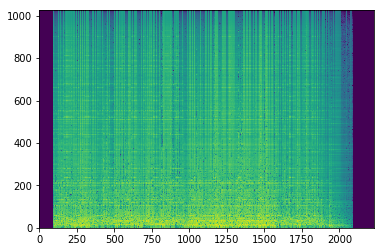

In [296]:
plt.pcolormesh(np.log(np.abs(result_stft) + 1e-5))
display.display(display.Audio(result, rate = sampling_rate))

In [297]:
# One W factor and its usage in mario
test = np.angle(mario_stft)*np.outer(w[:, 1], mario_h[1])
display.display(display.Audio(istft(test), rate = sampling_rate))

In [300]:
# One W factor and its usage in the output
test = np.angle(spectrogram)*np.outer(w[:, 4], h[4])
display.display(display.Audio(istft(test), rate = sampling_rate))